In [1]:
#  Imports 
import os
import numpy as np
import pandas as pd
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import Dataset, DataLoader
from sklearn.preprocessing import MinMaxScaler
import matplotlib.pyplot as plt
from tqdm import tqdm, trange
from sklearn.model_selection import ParameterGrid

In [2]:
#  Device Configuration 
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print("Using device:", device)

#  Global Hyperparameters 
timesteps = 50           
batch_size = 64           
grid_search_epochs = 50   
final_epochs = 500          
test_ratio = 0.2           
max_len = 1000             

#  Folder Containing Data Files 
folder_path = "./EXDATA"    

#  Grid Search Config 
use_default_params = False  # Set to False to trigger grid search

Using device: cuda


In [3]:
#  Input and Target Columns 
acc_input = ['aextx', 'Gap', 'Kh', 'Damping', 'M', 'K']

acc_target = ['ACCs2', 'ACCs3', 'ACCs4', 'ACCs5']  # acceleration outputs

#  Combine all required columns 
all_columns = list(set(acc_input + acc_target))


In [4]:
#  Load a single file and compute derived features 
def load_file(file_path):
    df = pd.read_csv(file_path, sep='\t', engine='python')
    df = df.dropna().reset_index(drop=True)
    df = df.iloc[::10].reset_index(drop=True)
    return df

In [5]:
#  Normalize globally 
def normalize_df_with_scaler(df, columns):
    scaler = MinMaxScaler()
    df[columns] = scaler.fit_transform(df[columns])
    return df, scaler

In [6]:
#  Split into chunks 
def split_into_chunks(df, max_len):
    num_chunks = int(np.floor(len(df) / max_len))
    return [df.iloc[i * max_len:(i + 1) * max_len].reset_index(drop=True)
            for i in range(num_chunks) if len(df.iloc[i * max_len:(i + 1) * max_len]) > timesteps]


In [7]:
#  Preprocess all files 
def preprocess_multiple_files(folder_path, all_columns, max_len=2000, test_ratio=0.2):
    file_paths = sorted([os.path.join(folder_path, f) for f in os.listdir(folder_path) if f.endswith('.txt')])
    all_chunks = []
    global_df = pd.DataFrame()

    for path in file_paths:
        df = load_file(path)
        global_df = pd.concat([global_df, df], ignore_index=True)

    global_df, scaler = normalize_df_with_scaler(global_df.copy(), all_columns)
    chunks = split_into_chunks(global_df, max_len)
    np.random.seed(42)
    np.random.shuffle(chunks)
    split_idx = int(len(chunks) * (1 - test_ratio))
    train_chunks = chunks[:split_idx]
    test_chunks = chunks[split_idx:]
    return train_chunks, test_chunks, scaler

In [8]:
#  Run preprocessing 
print("Preprocessing .txt files from folder...")
cached_train_data, cached_test_data, acc_scaler = preprocess_multiple_files(folder_path, all_columns, max_len, test_ratio)
print(f"  Loaded chunks → Train: {len(cached_train_data)}, Test: {len(cached_test_data)}")

Preprocessing .txt files from folder...
  Loaded chunks → Train: 91, Test: 23


In [9]:
#  Plot Raw Acceleration Signals 
def plot_raw_acc_signals(folder_path, target_cols):
    txt_files = sorted([f for f in os.listdir(folder_path) if f.endswith('.txt')])
    for fname in txt_files:
        file_path = os.path.join(folder_path, fname)
        df = load_file(file_path)
        for col in target_cols:
            if col in df.columns:
                plt.figure(figsize=(12, 4))
                plt.plot(df[col], label=f"{col} — {fname}")
                plt.title(f"Raw Signal — {col}")
                plt.xlabel("Time Step")
                plt.ylabel("Acceleration (g)")
                plt.legend()
                plt.grid(True)
                plt.tight_layout()
                plt.show()
            else:
                print(f" Column '{col}' not found in {fname}")

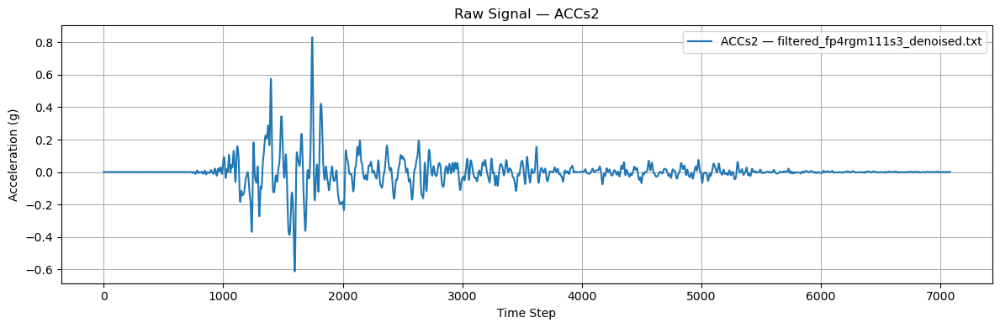

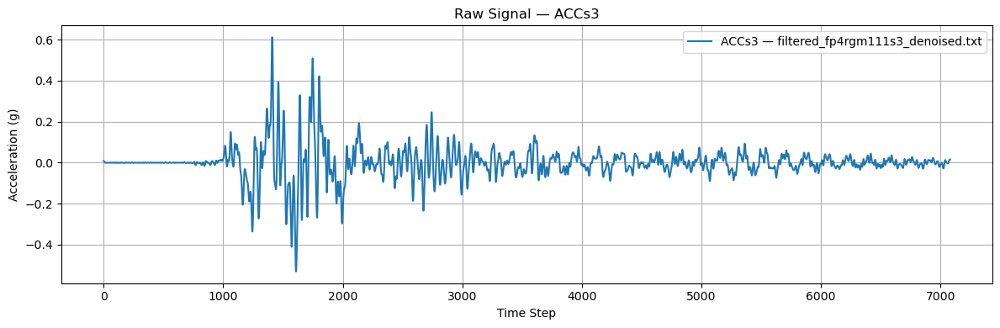

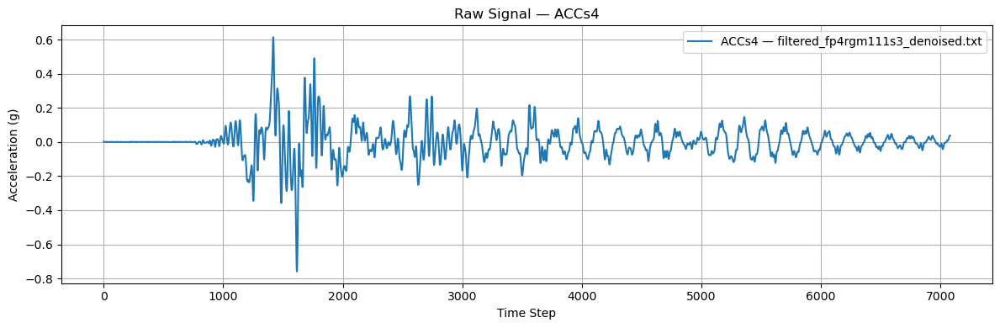

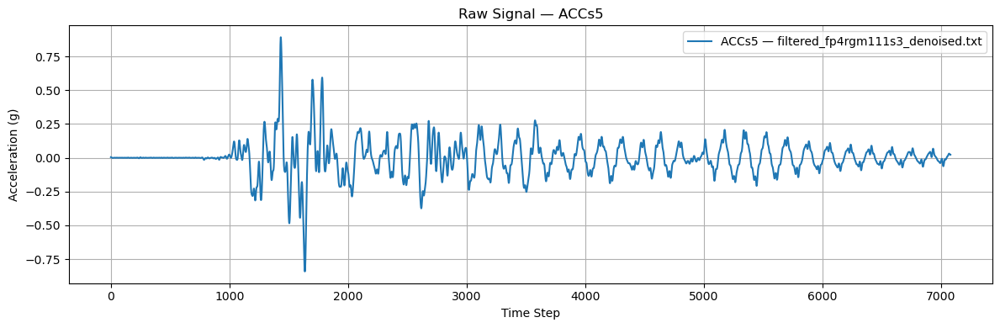

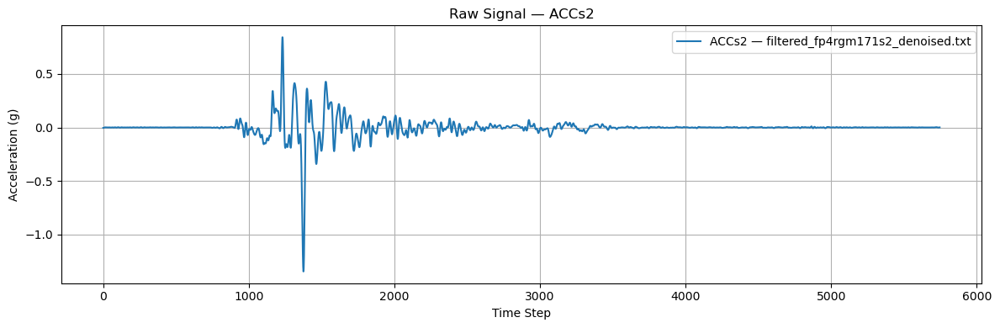

...

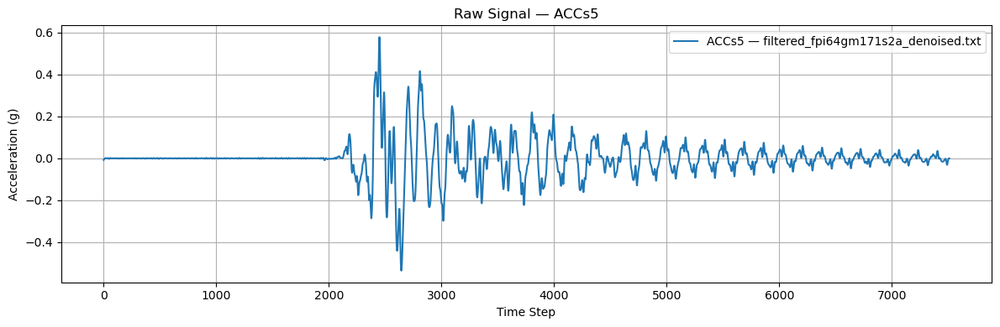

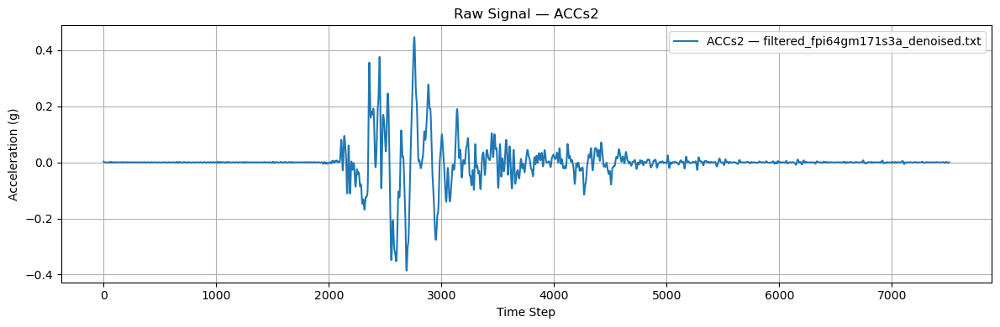

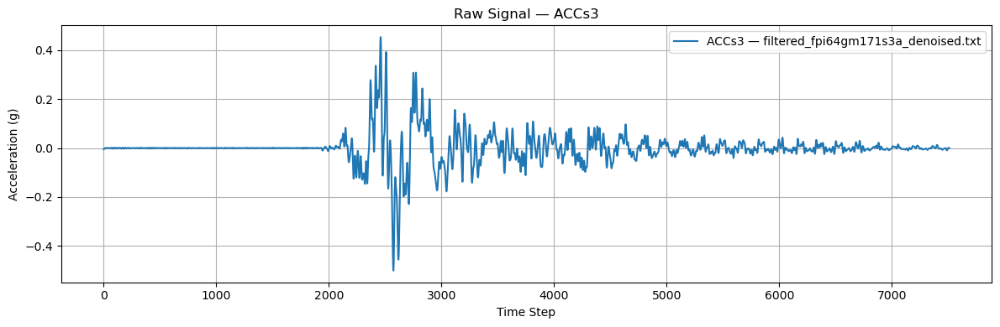

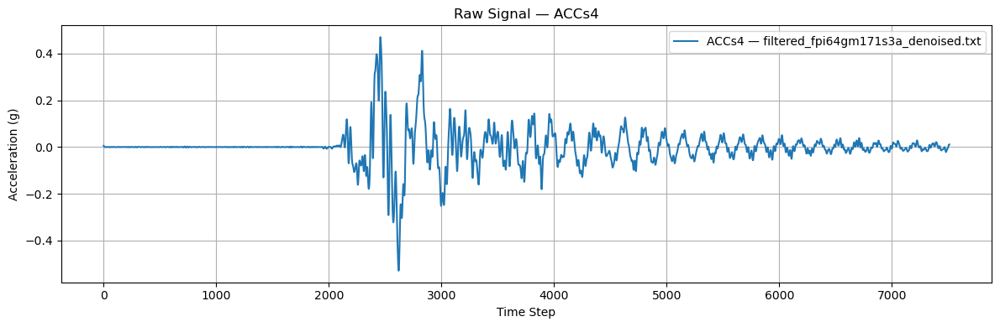

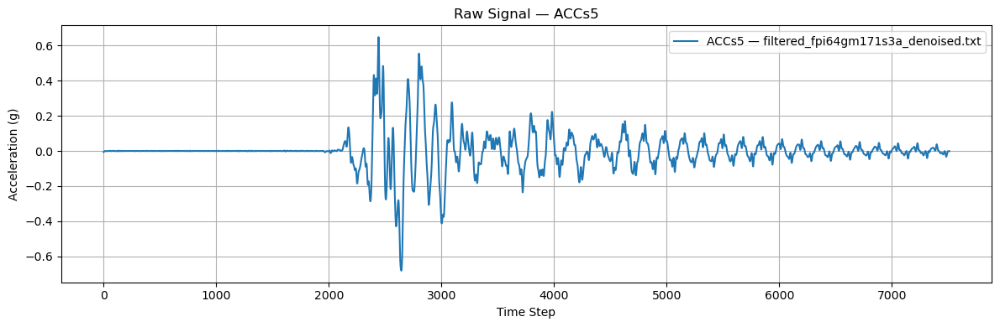

In [10]:
plot_raw_acc_signals(folder_path, ['ACCs2', 'ACCs3', 'ACCs4', 'ACCs5'])


In [11]:
#  Plot Normalized Acceleration Signals 
def plot_normalized_acc_signals(folder_path, target_cols, scaler):
    txt_files = sorted([f for f in os.listdir(folder_path) if f.endswith('.txt')])
    for fname in txt_files:
        file_path = os.path.join(folder_path, fname)
        df = load_file(file_path)

        if all(col in df.columns for col in scaler.feature_names_in_):
            df_norm = df.copy()
            df_norm[scaler.feature_names_in_] = scaler.transform(df_norm[scaler.feature_names_in_])

            for col in target_cols:
                if col in df_norm.columns:
                    plt.figure(figsize=(12, 4))
                    plt.plot(df_norm[col], label=f"{col} — {fname}")
                    plt.title(f"Normalized Signal — {col}")
                    plt.xlabel("Time Step")
                    plt.ylabel("Normalized Value (0–1)")
                    plt.legend()
                    plt.grid(True)
                    plt.tight_layout()
                    plt.show()
                else:
                    print(f" Column '{col}' not found in {fname}")
        else:
            print(f" Skipping file {fname} (missing scaler columns)")


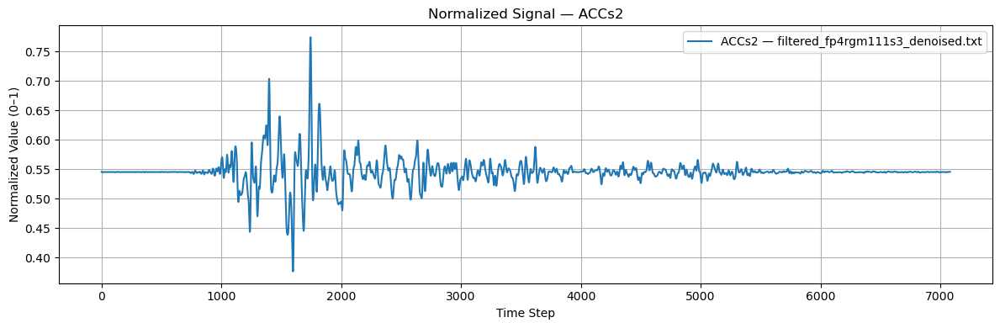

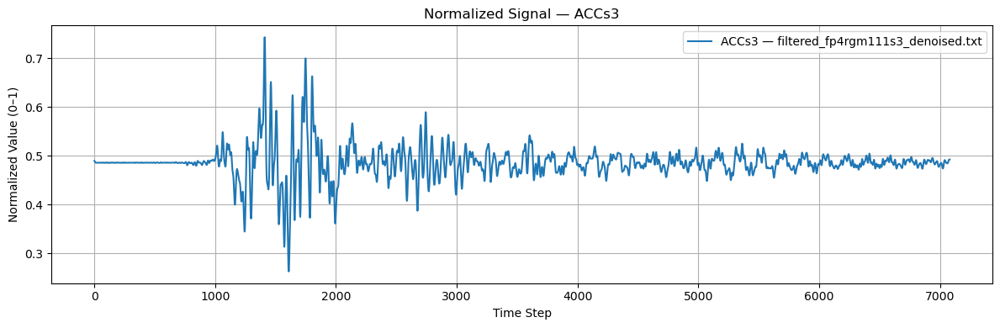

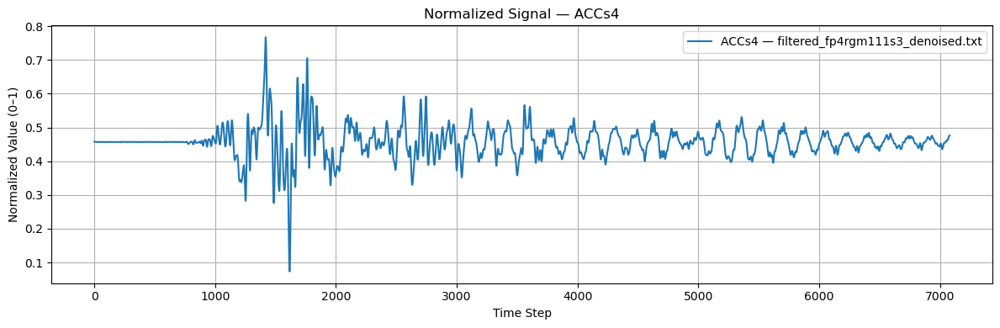

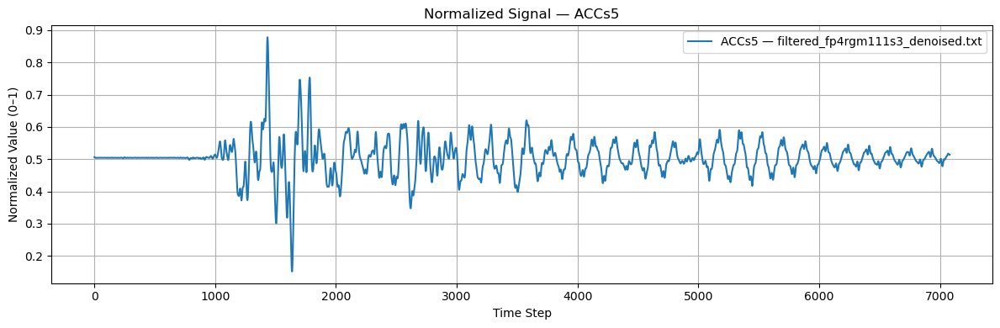

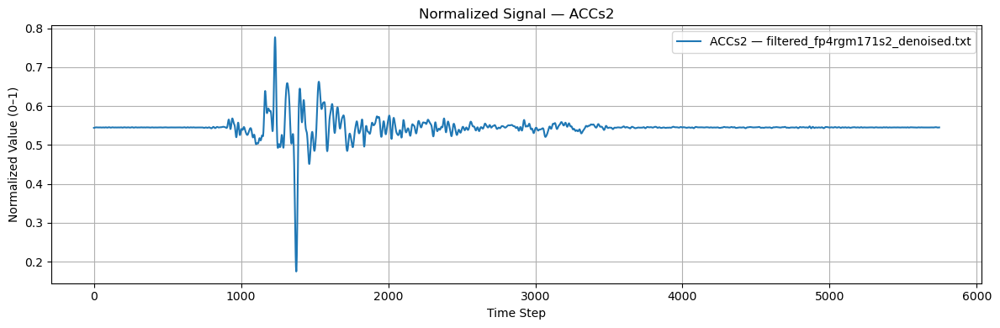

...

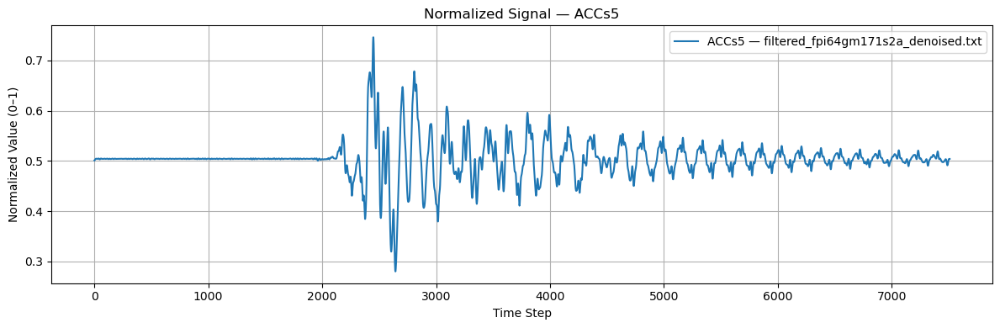

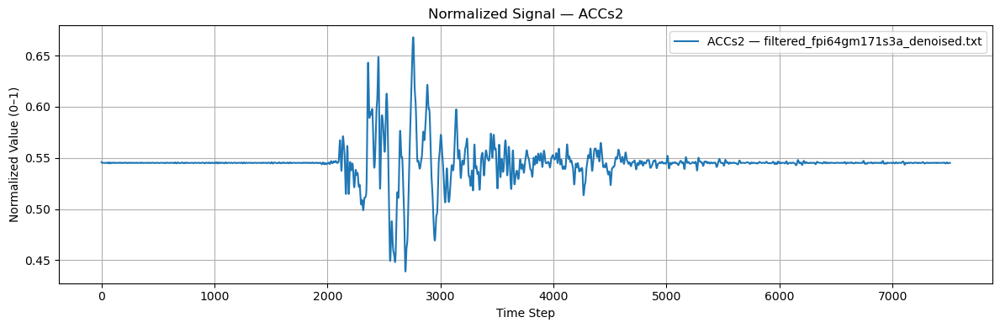

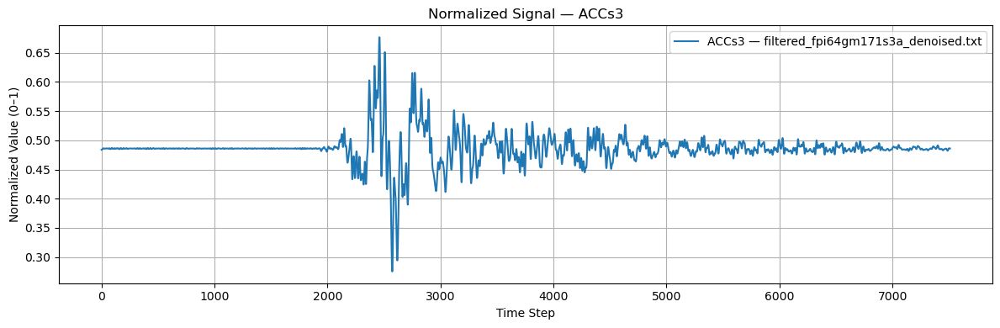

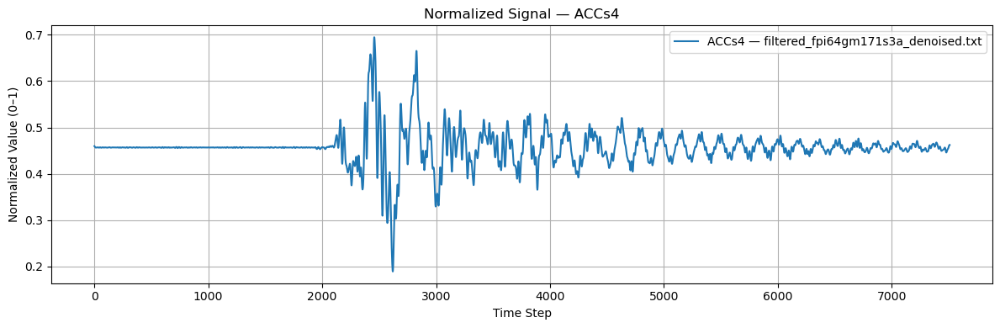

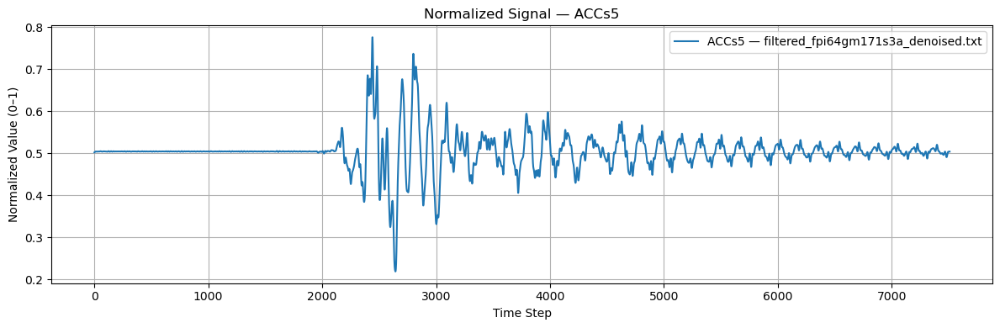

In [12]:
#  Plot Normalized Signals 
plot_normalized_acc_signals(folder_path, ['ACCs2', 'ACCs3', 'ACCs4', 'ACCs5'], acc_scaler)

In [10]:
# ==== Custom Dataset ====
class SequenceDataset(Dataset):
    def __init__(self, data_chunks, input_cols, target_cols, timesteps=50):
        self.samples = []
        for df in data_chunks:
            if not all(col in df.columns for col in input_cols + target_cols):
                continue
            for i in range(len(df) - timesteps):
                x_seq = df[input_cols].iloc[i:i+timesteps].values.astype(np.float32)
                y_val = df[target_cols].iloc[i+timesteps].values.astype(np.float32)
                self.samples.append((x_seq, y_val))

    def __len__(self):
        return len(self.samples)

    def __getitem__(self, idx):
        x, y = self.samples[idx]
        return torch.tensor(x), torch.tensor(y)

In [11]:
# ==== Create DataLoader ====
def create_loader(data_chunks, input_cols, target_cols, timesteps=50, batch_size=64):
    dataset = SequenceDataset(data_chunks, input_cols, target_cols, timesteps)
    return DataLoader(dataset, batch_size=batch_size, shuffle=False)

# ==== Create ACC DataLoaders ====
print("Creating DataLoaders...")
loader_acc_train = create_loader(cached_train_data, acc_input, acc_target, timesteps, batch_size)
loader_acc_test  = create_loader(cached_test_data, acc_input, acc_target, timesteps, batch_size)
print(f"  Training samples: {len(loader_acc_train.dataset)}")
print(f"  Testing samples : {len(loader_acc_test.dataset)}")


Creating DataLoaders...
  Training samples: 86450
  Testing samples : 21850


In [12]:
# ==== LSTM Model Definition ====
class LSTM_Model(nn.Module):
    def __init__(self, input_size, hidden_size, num_layers, dropout, output_size):
        super(LSTM_Model, self).__init__()
        self.lstm = nn.LSTM(input_size, hidden_size, num_layers,
                            batch_first=True, dropout=dropout)
        self.fc = nn.Linear(hidden_size, output_size)
        self.leakyrelu = nn.LeakyReLU(0.01)
        self.init_weights()

    def init_weights(self):
        for name, param in self.named_parameters():
            if 'weight' in name:
                nn.init.xavier_uniform_(param)
            elif 'bias' in name:
                nn.init.zeros_(param)

    def forward(self, x):
        lstm_out, _ = self.lstm(x)
        out = self.leakyrelu(lstm_out[:, -1, :])
        return self.fc(out)


In [13]:
def grid_search(train_loader, test_loader, input_size, output_size):
    best_params = None
    best_loss = float('inf')
    criterion = nn.MSELoss()

    print("\n[GRID SEARCH] Searching for best hyperparameters...\n")
    for i, params in enumerate(ParameterGrid(grid_param_space), start=1):
        print(f"[{i}] Testing params: {params}")
        
        model = LSTM_Model(
            input_size=input_size,
            hidden_size=params['hidden_size'],
            num_layers=params['num_layers'],
            dropout=params['dropout'],
            output_size=output_size
        ).to(device)

        optimizer = optim.Adam(model.parameters(), lr=params['lr'])

        # Train for short cycles
        for epoch in range(grid_search_epochs):
            model.train()
            for x, y in train_loader:
                x, y = x.to(device), y.to(device)
                optimizer.zero_grad()
                loss = criterion(model(x), y)
                loss.backward()
                optimizer.step()

        # Evaluate on test set
        model.eval()
        total_loss = 0.0
        with torch.no_grad():
            for x, y in test_loader:
                x, y = x.to(device), y.to(device)
                loss = criterion(model(x), y)
                total_loss += loss.item()
        avg_loss = total_loss / len(test_loader)

        print(f"     Test Loss: {avg_loss:.6f}\n")

        # Update best if this is the best so far
        if avg_loss < best_loss:
            best_loss = avg_loss
            best_params = params

    print(f"[GRID SEARCH COMPLETE] Best params: {best_params} with test loss: {best_loss:.6f}")
    return best_params


In [14]:
default_params = {'hidden_size': 128, 'num_layers': 4, 'dropout': 0.2, 'lr': 0.001}
grid_param_space = {
    'hidden_size': [64, 128],
    'num_layers': [2, 3],
    'dropout': [0.1, 0.3],
    'lr': [0.001, 0.0005]
}

In [15]:
# ==== Select Parameters ====
input_size = len(acc_input)
output_size = len(acc_target)

if use_default_params:
    chosen_params = default_params
else:
    chosen_params = grid_search(
        train_loader=loader_acc_train,
        test_loader=loader_acc_test,
        input_size=input_size,
        output_size=output_size
    )

In [16]:
# ==== Final Training Function ====
def final_training(model, train_loader, test_loader, lr, model_name="acc"):
    optimizer = optim.Adam(model.parameters(), lr=lr)
    scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=50, gamma=0.5)
    criterion = nn.MSELoss()
    train_losses, test_losses = [], []

    print(f"\nTraining model: {model_name}")
    for epoch in trange(final_epochs, desc=f"Epochs ({model_name})"):
        model.train()
        total_train_loss = 0.0
        for x, y in train_loader:
            x, y = x.to(device), y.to(device)
            optimizer.zero_grad()
            loss = criterion(model(x), y)
            loss.backward()
            optimizer.step()
            total_train_loss += loss.item()
        train_losses.append(total_train_loss / len(train_loader))
        scheduler.step()

        model.eval()
        total_test_loss = 0.0
        with torch.no_grad():
            for x, y in test_loader:
                x, y = x.to(device), y.to(device)
                loss = criterion(model(x), y)
                total_test_loss += loss.item()
        test_losses.append(total_test_loss / len(test_loader))

    torch.save(model.state_dict(), f"final_lstm_model_{model_name}.pth")

    plt.figure(figsize=(8, 5))
    plt.plot(train_losses, label="Train MSE")
    plt.plot(test_losses, label="Test MSE", linestyle="--")
    plt.title(f"{model_name.upper()} — MSE vs Epoch")
    plt.xlabel("Epoch")
    plt.ylabel("Mean Squared Error")
    plt.legend()
    plt.grid(True)
    plt.tight_layout()
    plt.show()



Training model: acc


Epochs (acc): 100%|██████████| 500/500 [1:42:40<00:00, 12.32s/it]


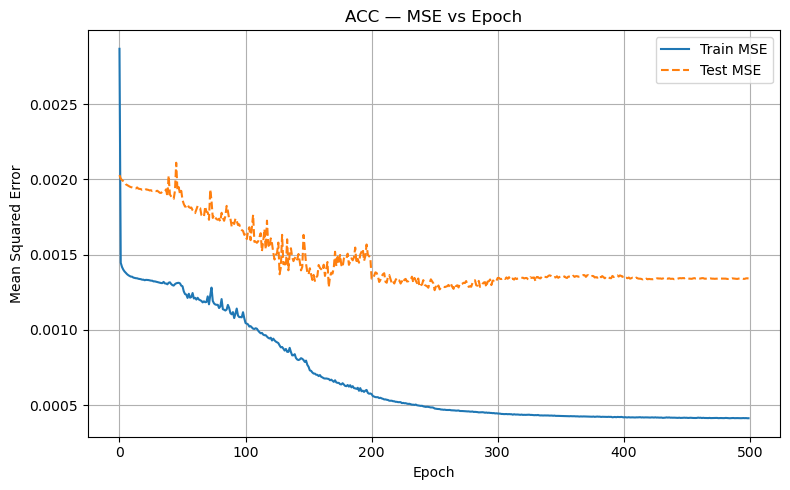

In [17]:
# ==== Initialize and Train the Model ====
model_acc = LSTM_Model(
    input_size=input_size,
    hidden_size=chosen_params['hidden_size'],
    num_layers=chosen_params['num_layers'],
    dropout=chosen_params['dropout'],
    output_size=output_size
).to(device)

final_training(
    model=model_acc,
    train_loader=loader_acc_train,
    test_loader=loader_acc_test,
    lr=chosen_params['lr'],
    model_name="acc"
)

In [18]:
def predict_and_plot_full_file(model, file_path, input_cols, target_cols, scaler, model_name="acc", timesteps=50, batch_size=512):
    print(f"\n[INFO] Predicting on entire file: {os.path.basename(file_path)}")

    # Load and normalize the full file using the training scaler
    df = load_file(file_path)
    df_norm = df.copy()
    df_norm[scaler.feature_names_in_] = scaler.transform(df_norm[scaler.feature_names_in_])

    # Create sliding window input-output pairs
    X = np.array([
        df_norm[input_cols].iloc[i:i+timesteps].values.astype(np.float32)
        for i in range(len(df_norm) - timesteps)
    ])
    Y = np.array([
        df_norm[target_cols].iloc[i+timesteps].values.astype(np.float32)
        for i in range(len(df_norm) - timesteps)
    ])

    # Predict in batches
    all_preds = []
    model.eval()
    for i in range(0, len(X), batch_size):
        x_batch = torch.tensor(X[i:i+batch_size]).to(device)
        with torch.no_grad():
            pred_batch = model(x_batch).cpu().numpy()
        all_preds.append(pred_batch)
    Y_pred = np.vstack(all_preds)

    # Inverse transform the predictions and targets
    dummy_true = np.zeros((len(Y), len(scaler.feature_names_in_)))
    dummy_pred = np.zeros_like(dummy_true)

    for i, col in enumerate(target_cols):
        idx = list(scaler.feature_names_in_).index(col)
        dummy_true[:, idx] = Y[:, i]
        dummy_pred[:, idx] = Y_pred[:, i]

    inv_true = scaler.inverse_transform(dummy_true)[:, [list(scaler.feature_names_in_).index(c) for c in target_cols]]
    inv_pred = scaler.inverse_transform(dummy_pred)[:, [list(scaler.feature_names_in_).index(c) for c in target_cols]]

    # Plot each target signal
    for j, col in enumerate(target_cols):
        plt.figure(figsize=(14, 4))
        plt.plot(inv_true[:, j], label=f"True {col}", linewidth=1.5)
        plt.plot(inv_pred[:, j], '--', label=f"Predicted {col}", linewidth=1.5)
        plt.title(f"{model_name.upper()} — {col} — Full File")
        plt.xlabel("Time Step")
        plt.ylabel("Original Units")
        plt.legend()
        plt.grid(True)
        plt.tight_layout()
        plt.show()

    return inv_true, inv_pred



=== Predicting and plotting: filtered_fp4rgm111s3_denoised.txt ===

[INFO] Predicting on entire file: filtered_fp4rgm111s3_denoised.txt


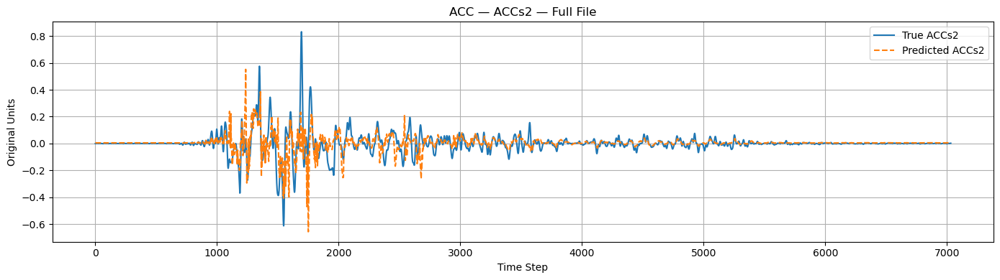

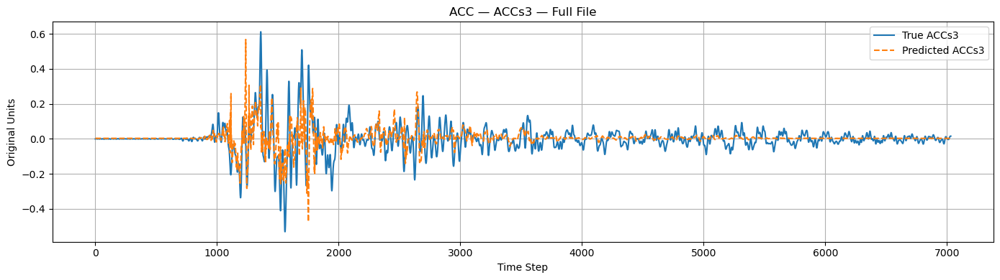

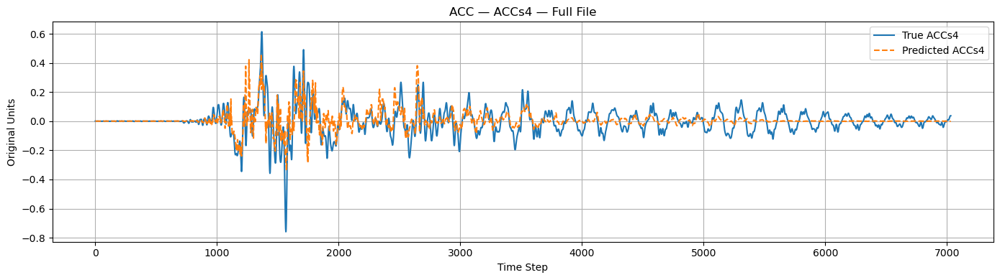

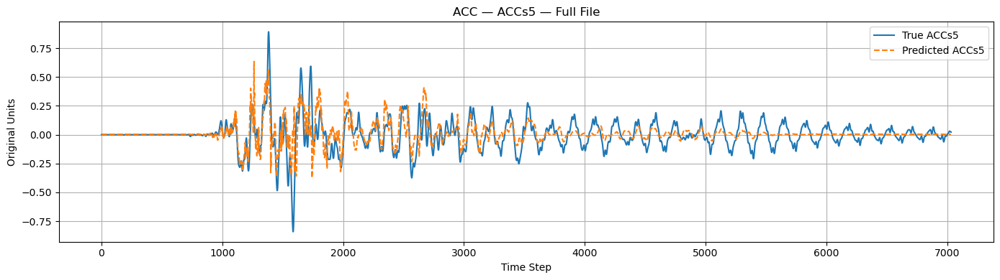


=== Predicting and plotting: filtered_fp4rgm171s2_denoised.txt ===

[INFO] Predicting on entire file: filtered_fp4rgm171s2_denoised.txt


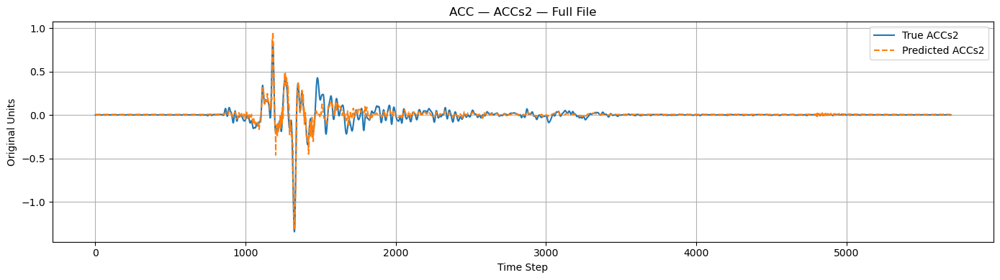

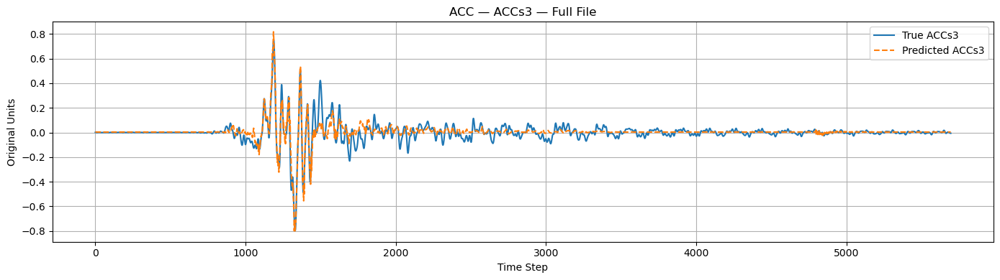

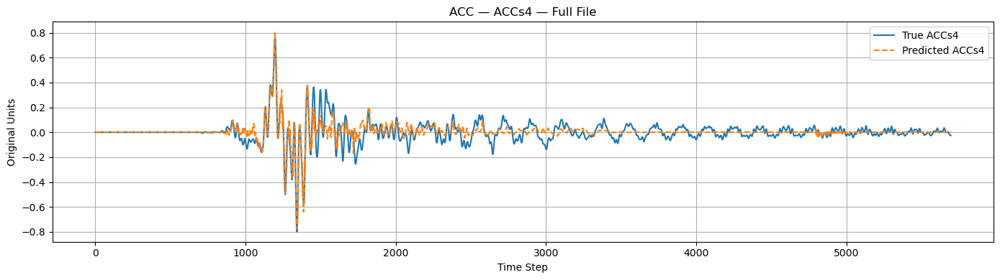

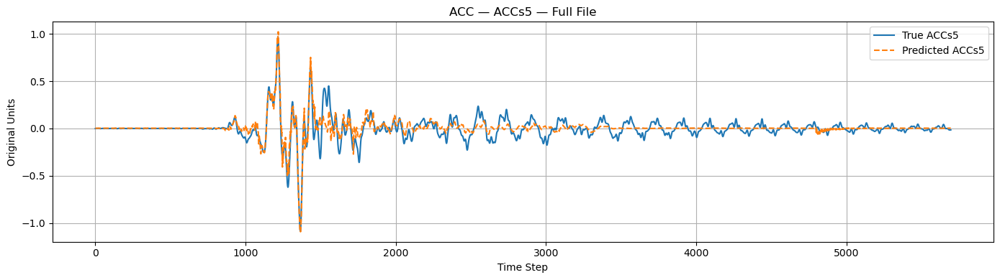


=== Predicting and plotting: filtered_fp4rgm171s3_denoised.txt ===

[INFO] Predicting on entire file: filtered_fp4rgm171s3_denoised.txt


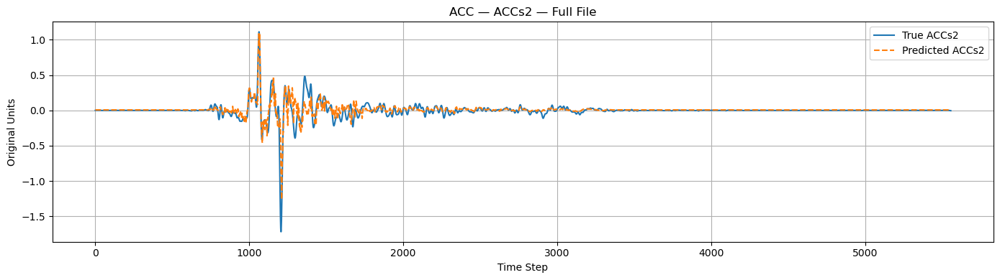

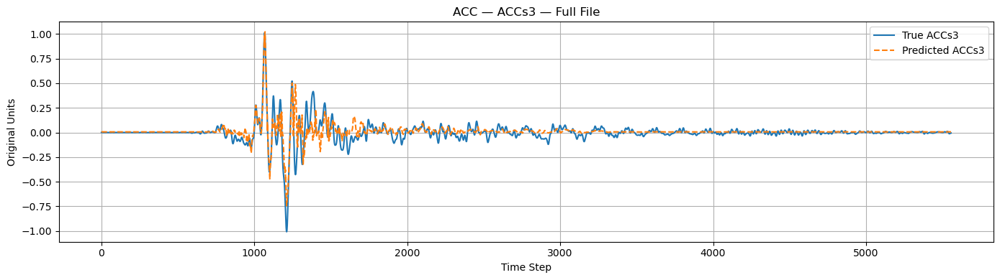

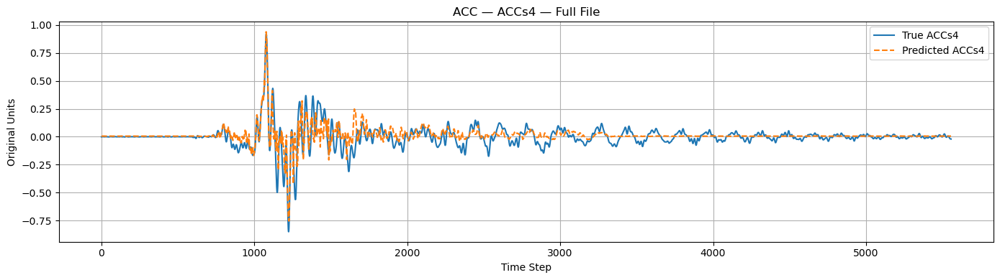

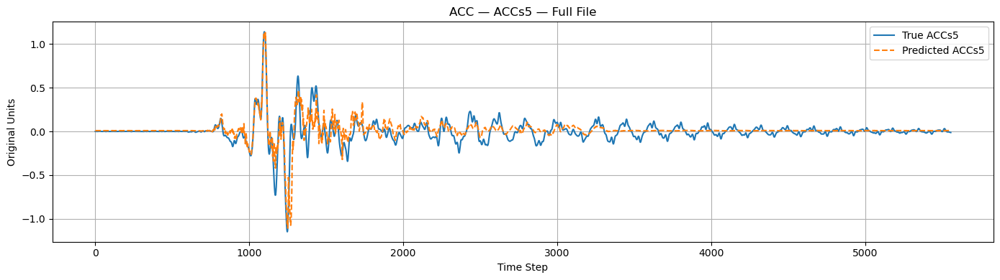


=== Predicting and plotting: filtered_fp4rgm71s3_denoised.txt ===

[INFO] Predicting on entire file: filtered_fp4rgm71s3_denoised.txt


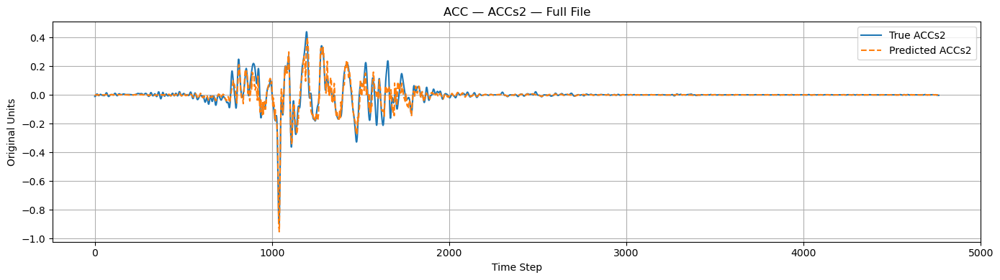

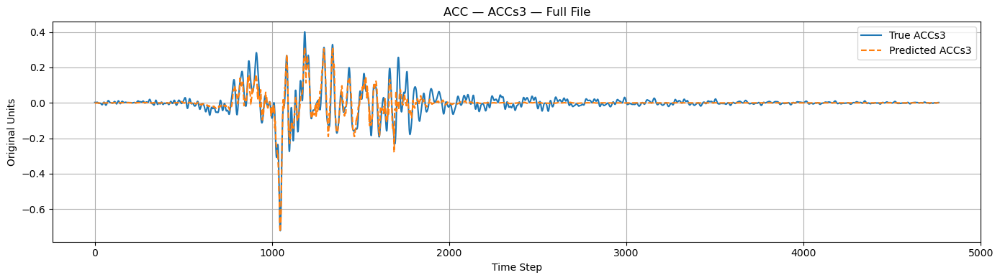

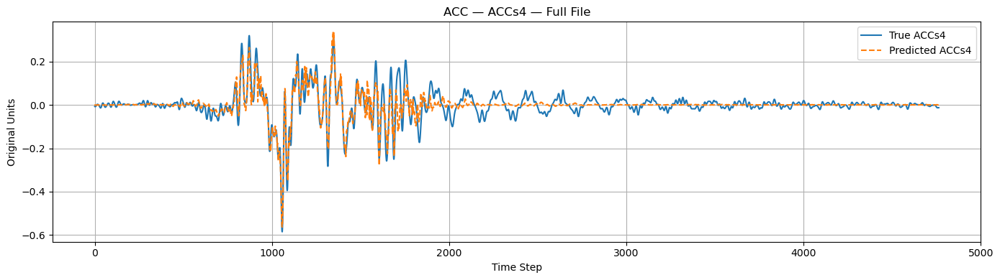

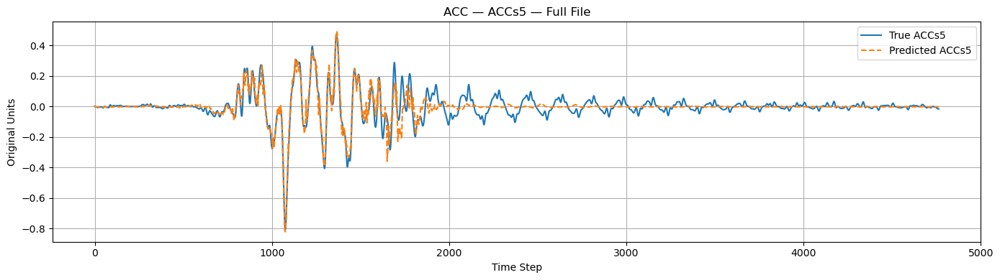


=== Predicting and plotting: filtered_fp4rngm111s3_denoised.txt ===

[INFO] Predicting on entire file: filtered_fp4rngm111s3_denoised.txt


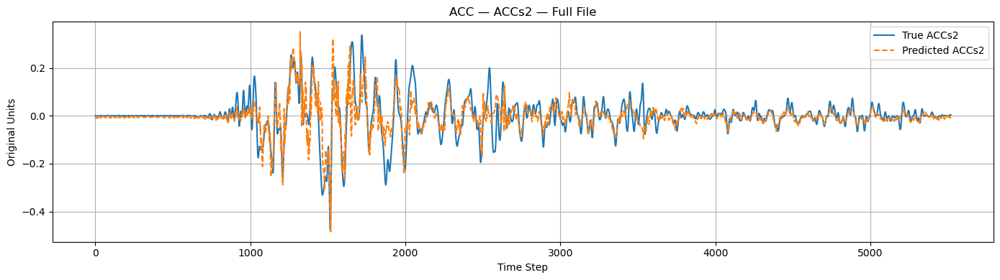

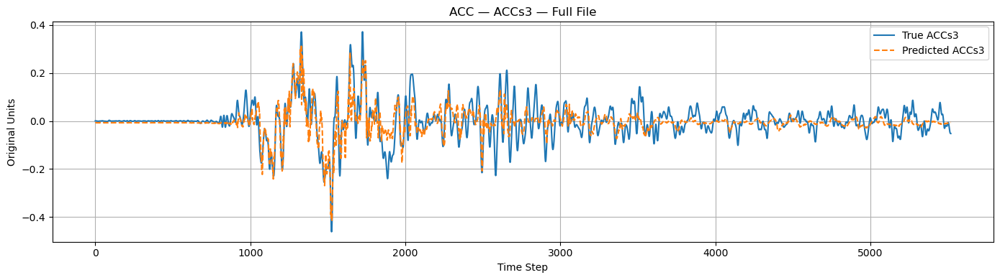

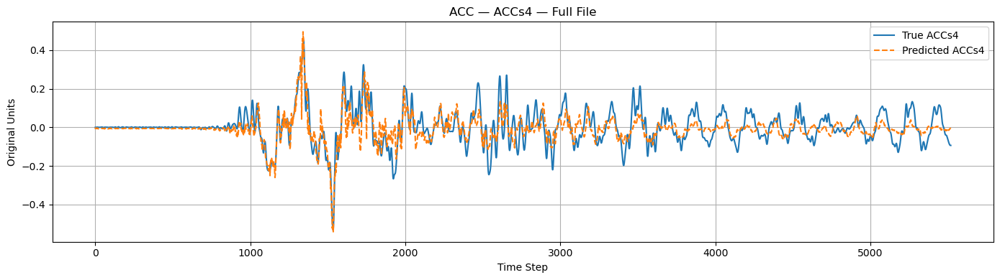

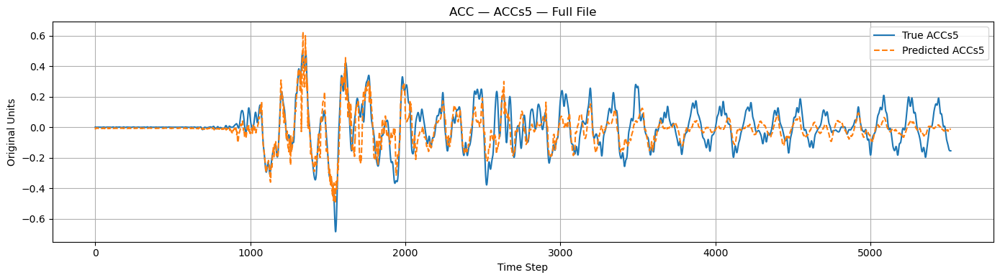


=== Predicting and plotting: filtered_fp4rngm171s3_denoised.txt ===

[INFO] Predicting on entire file: filtered_fp4rngm171s3_denoised.txt


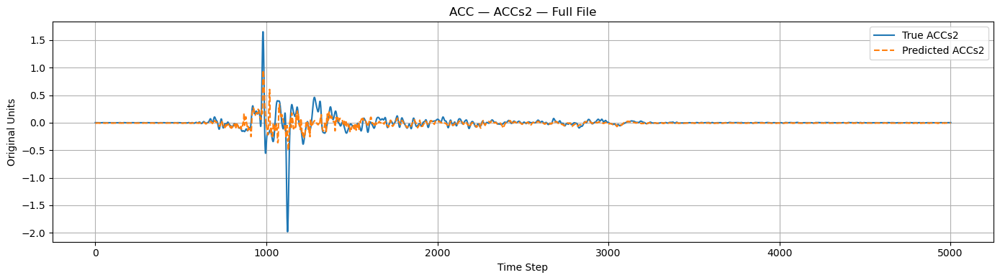

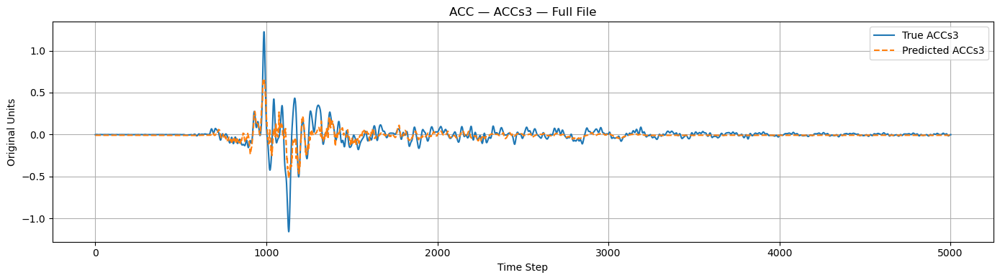

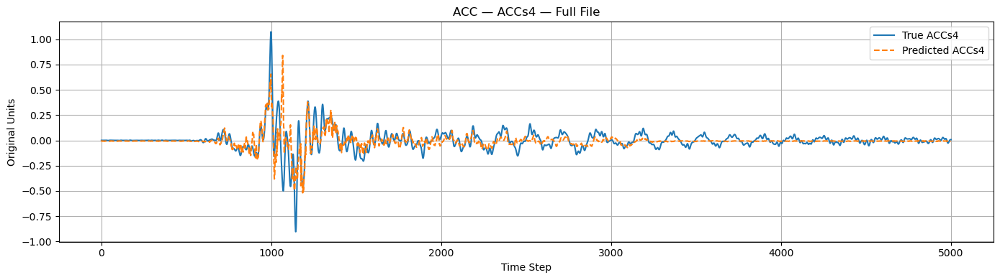

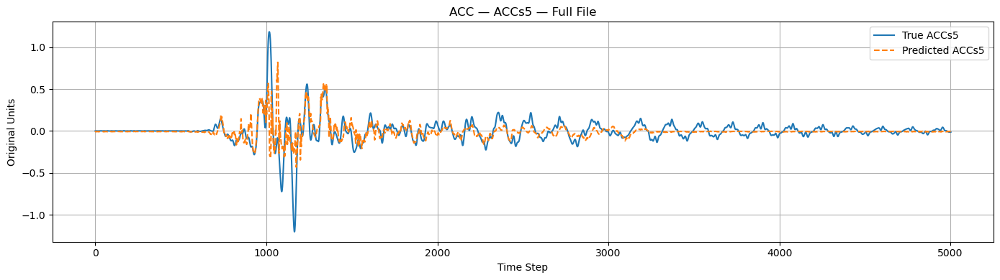


=== Predicting and plotting: filtered_fp4rngm71s3_denoised.txt ===

[INFO] Predicting on entire file: filtered_fp4rngm71s3_denoised.txt


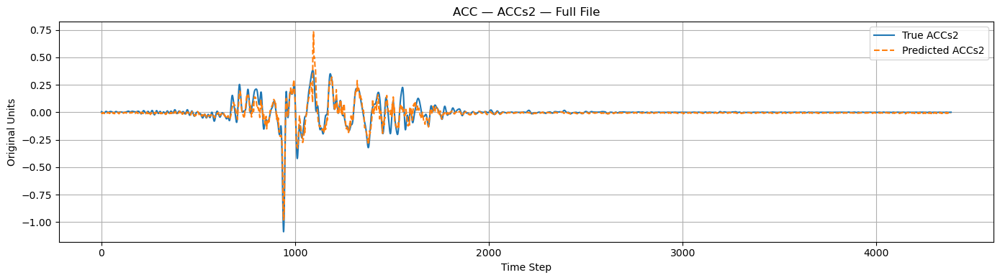

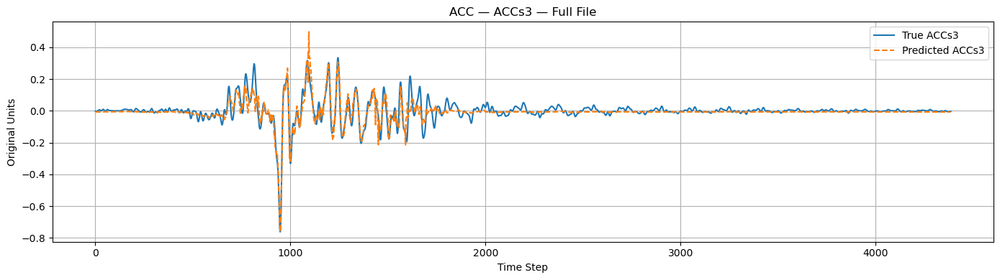

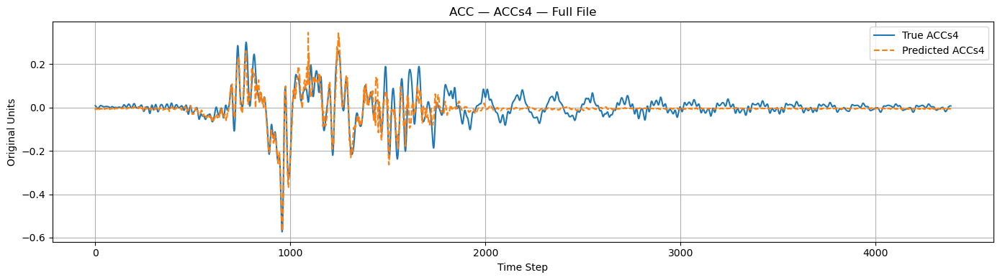

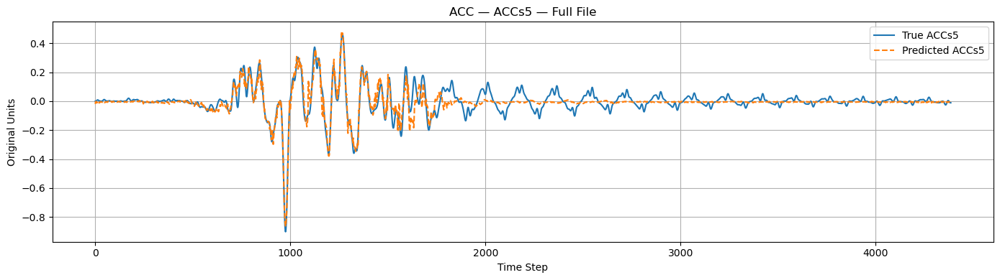


=== Predicting and plotting: filtered_fp5rgm171s3_denoised.txt ===

[INFO] Predicting on entire file: filtered_fp5rgm171s3_denoised.txt


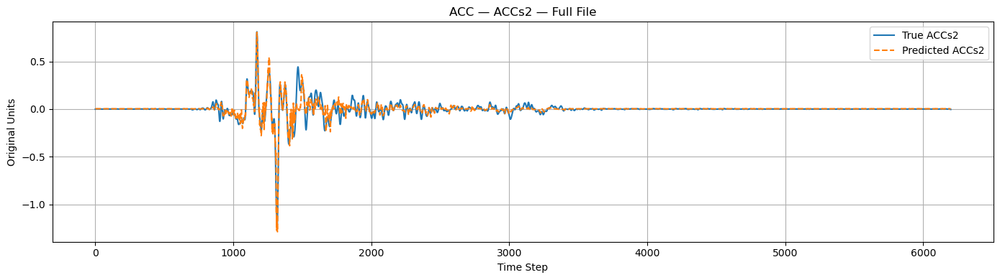

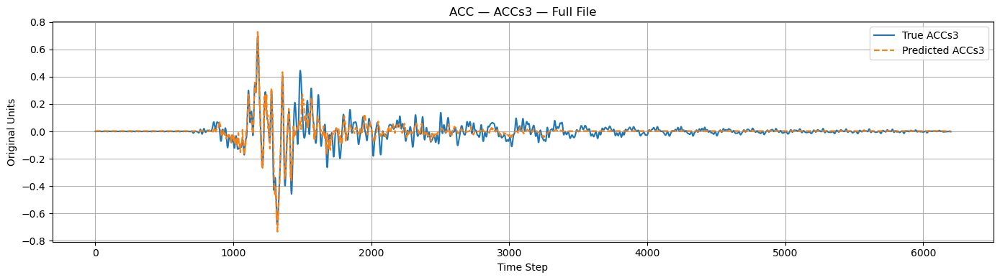

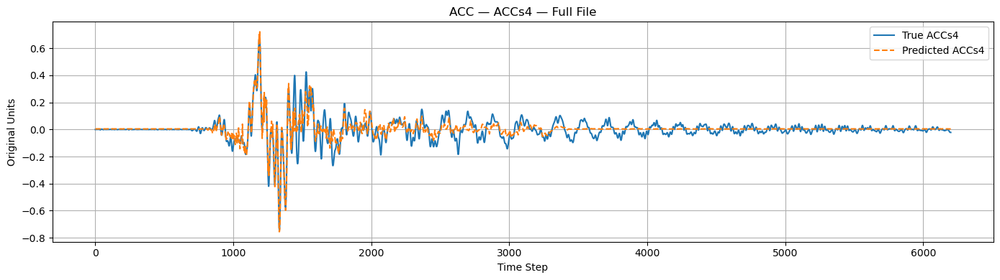

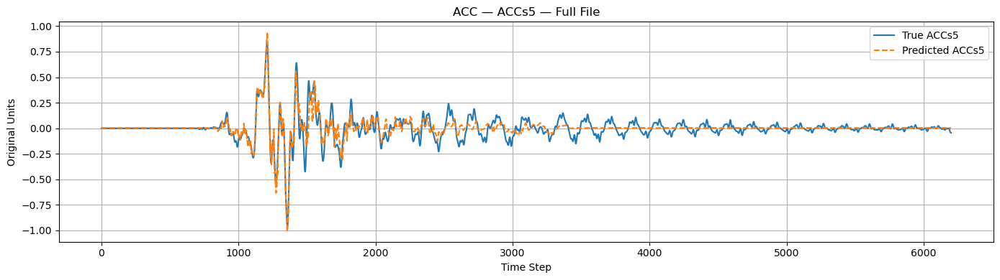


=== Predicting and plotting: filtered_fp6rgm171s3_denoised.txt ===

[INFO] Predicting on entire file: filtered_fp6rgm171s3_denoised.txt


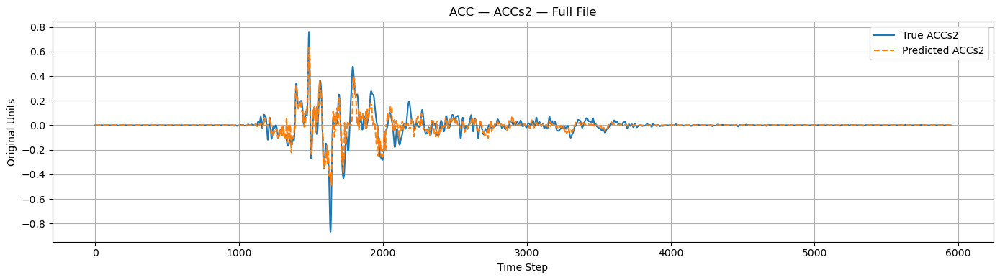

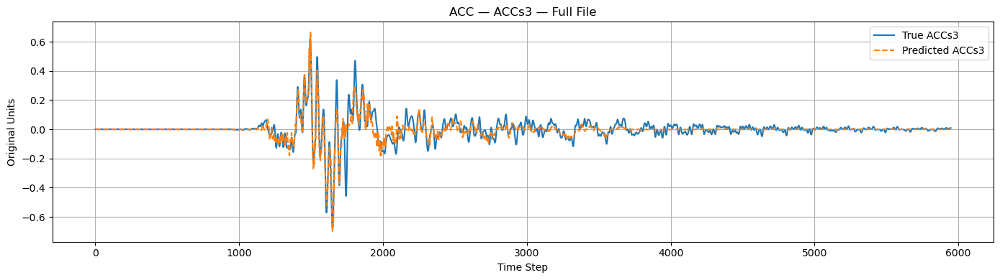

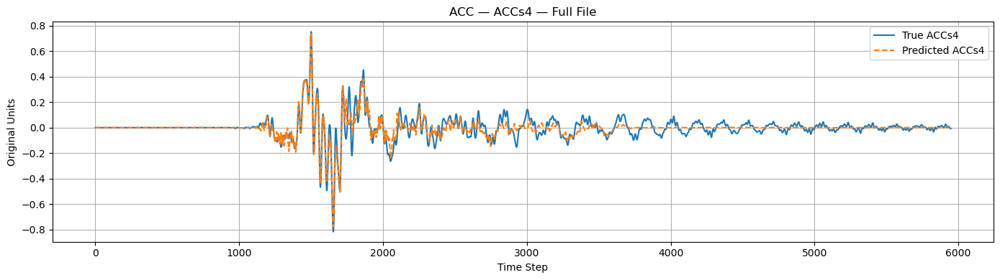

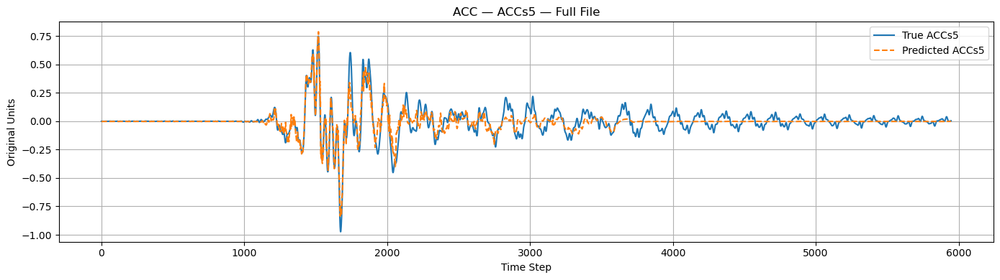


=== Predicting and plotting: filtered_fp6rngm171s3_denoised.txt ===

[INFO] Predicting on entire file: filtered_fp6rngm171s3_denoised.txt


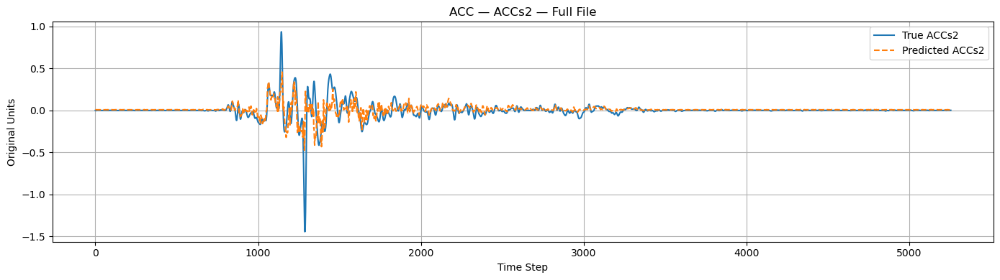

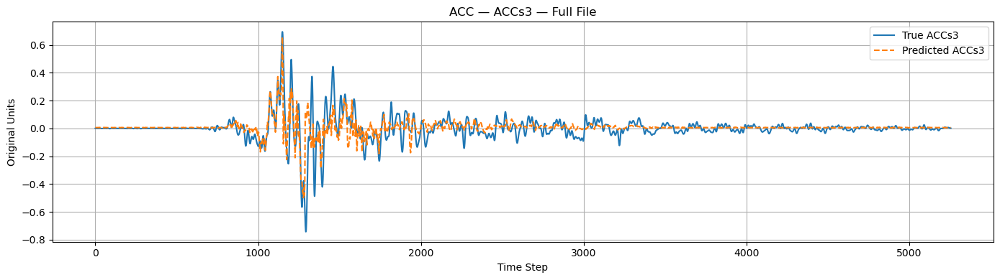

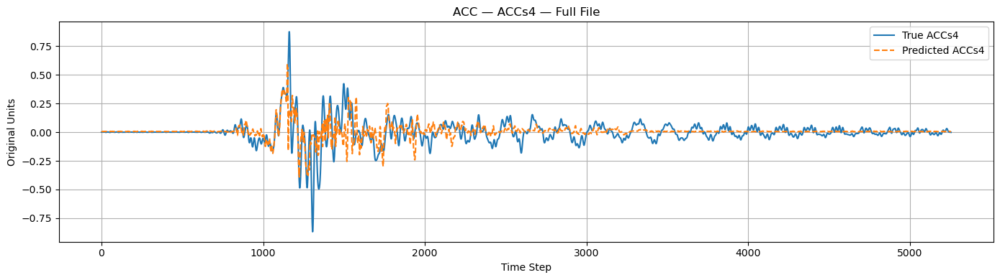

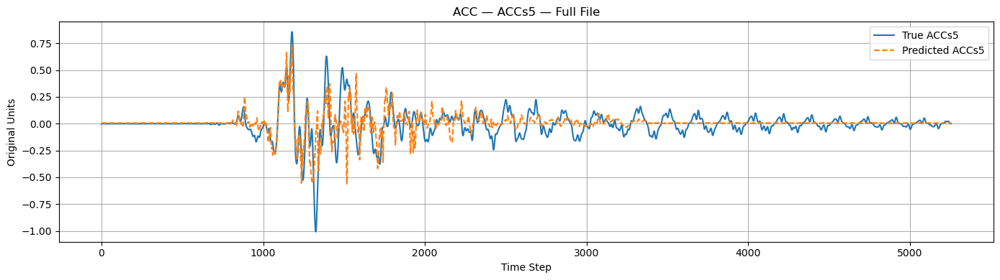


=== Predicting and plotting: filtered_fpi46gm111s3_denoised.txt ===

[INFO] Predicting on entire file: filtered_fpi46gm111s3_denoised.txt


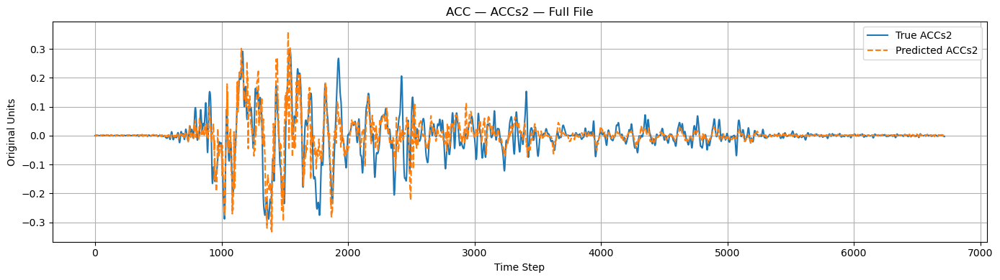

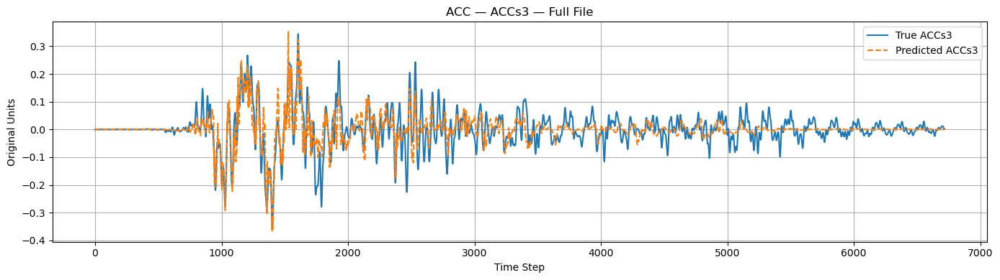

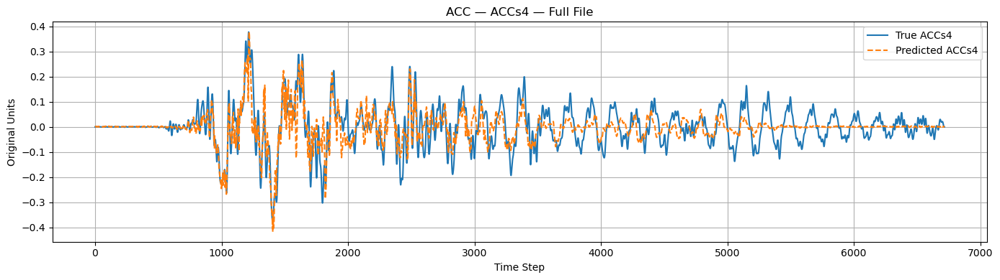

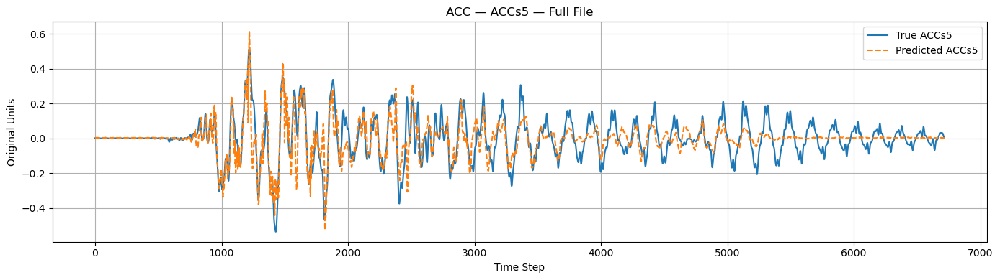


=== Predicting and plotting: filtered_fpi46gm171s2_denoised.txt ===

[INFO] Predicting on entire file: filtered_fpi46gm171s2_denoised.txt


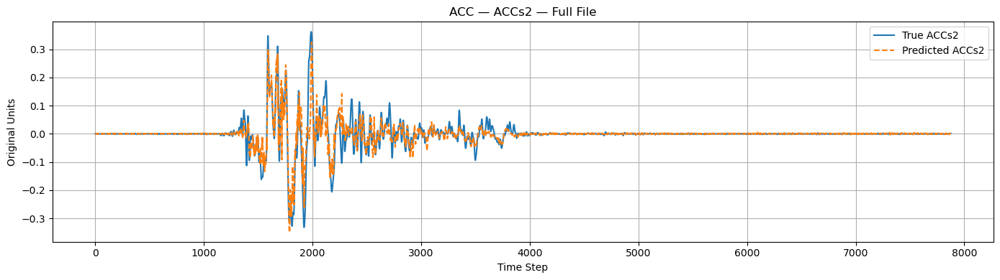

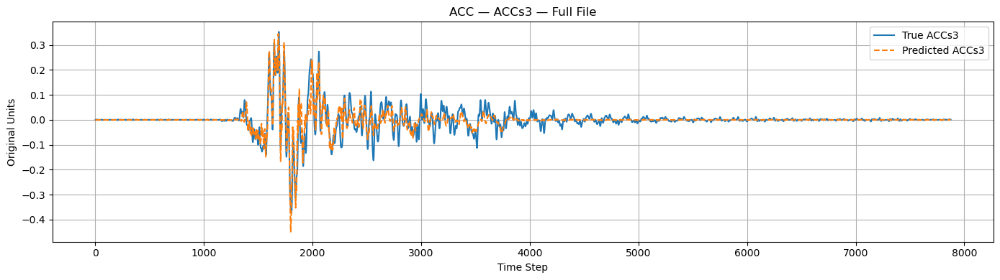

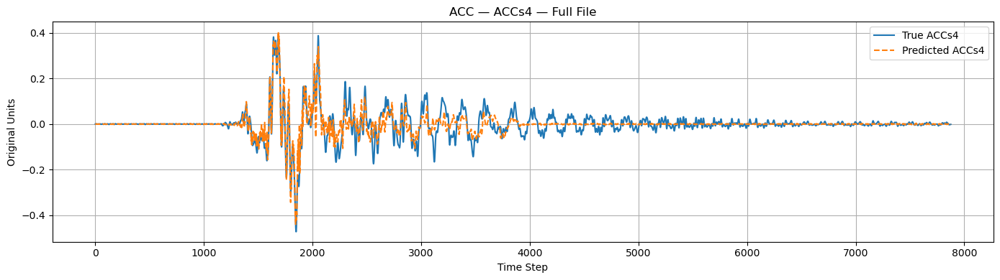

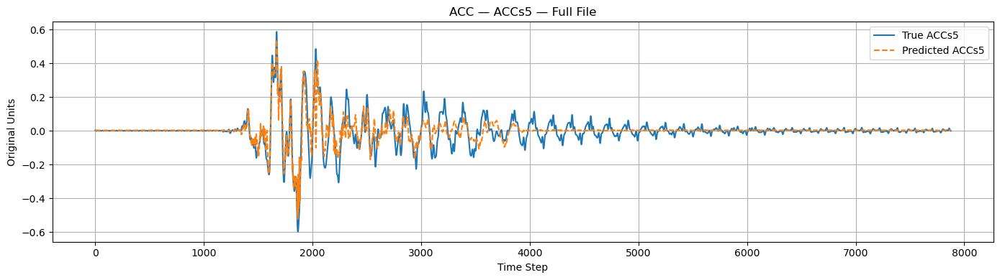


=== Predicting and plotting: filtered_fpi46gm171s3_denoised.txt ===

[INFO] Predicting on entire file: filtered_fpi46gm171s3_denoised.txt


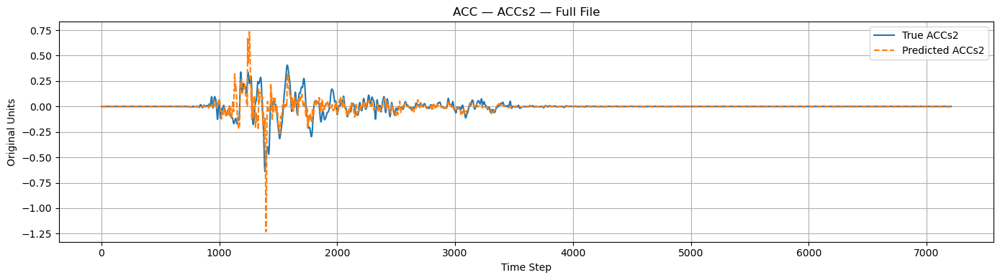

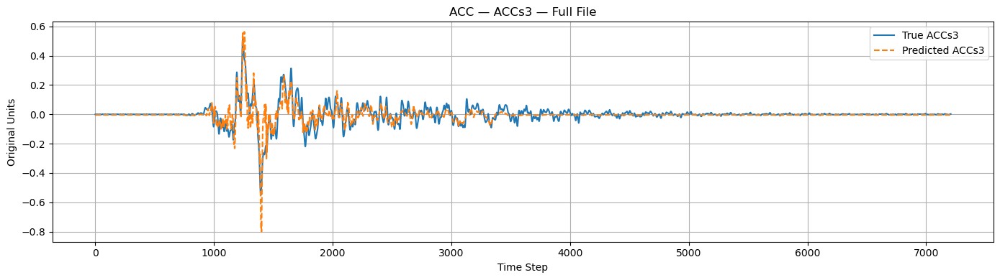

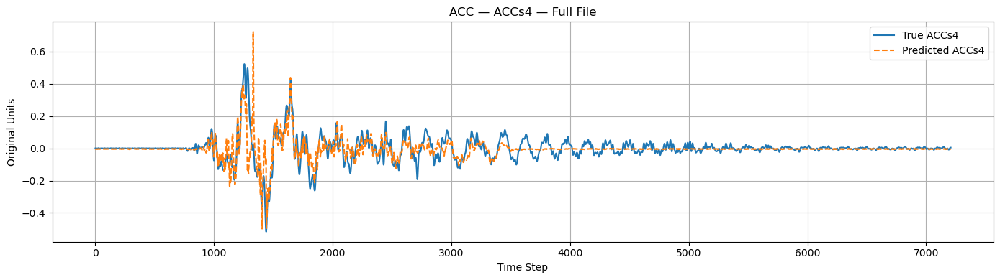

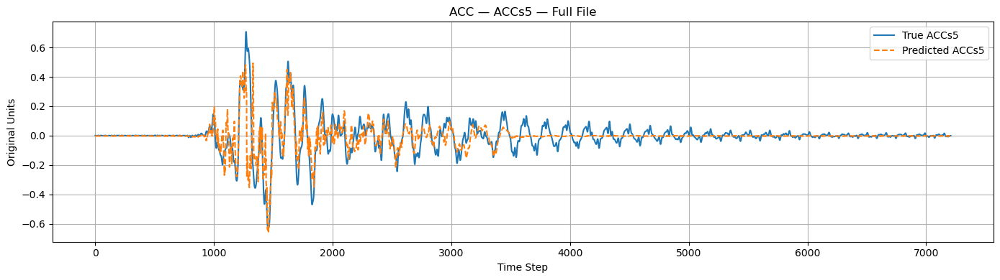


=== Predicting and plotting: filtered_fpi46gm71s3_denoised.txt ===

[INFO] Predicting on entire file: filtered_fpi46gm71s3_denoised.txt


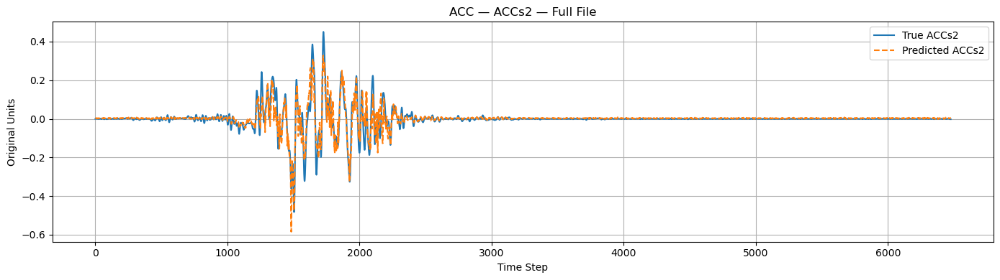

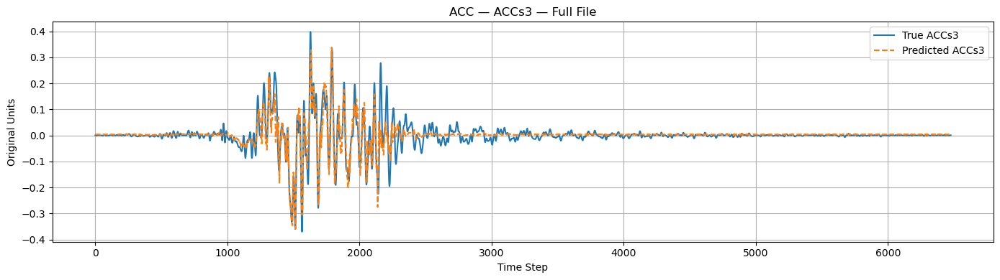

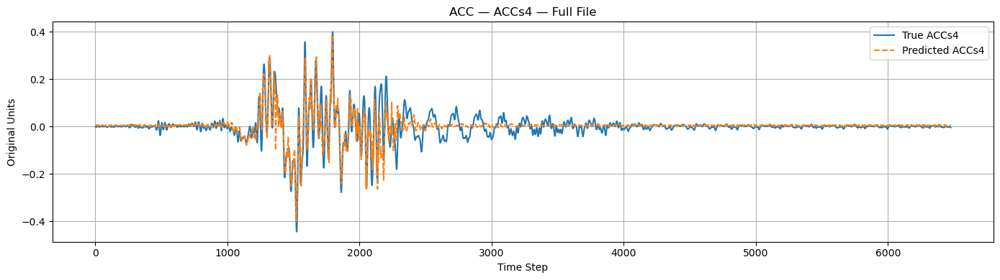

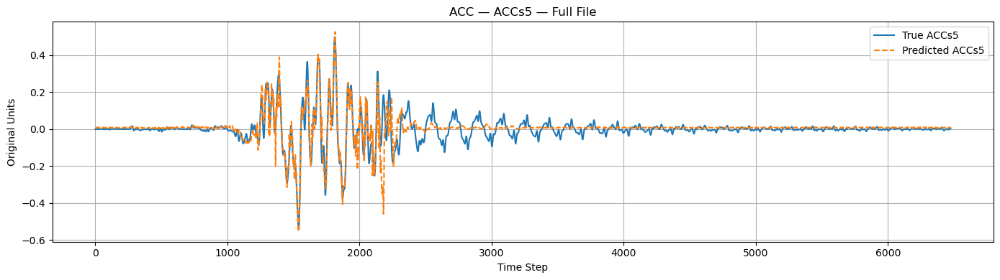


=== Predicting and plotting: filtered_fpi62gm171s1_denoised.txt ===

[INFO] Predicting on entire file: filtered_fpi62gm171s1_denoised.txt


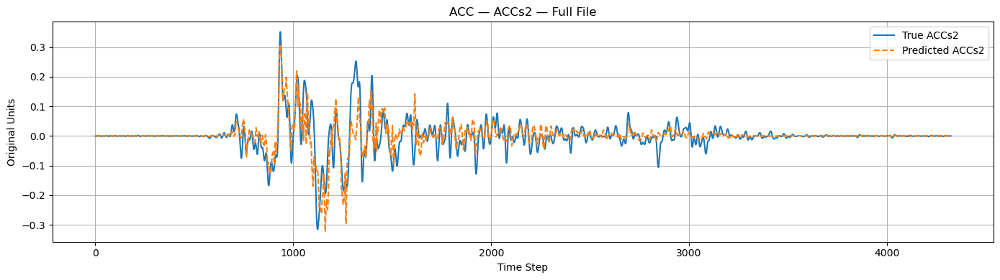

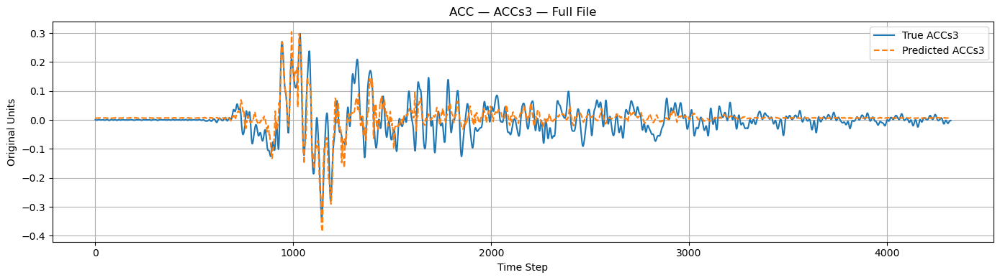

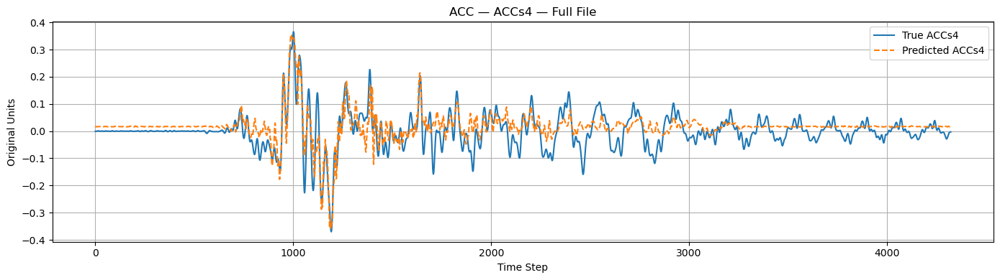

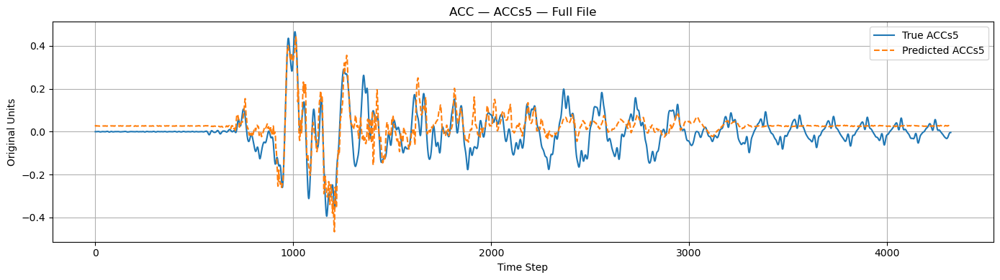


=== Predicting and plotting: filtered_fpi62gm171s2_denoised.txt ===

[INFO] Predicting on entire file: filtered_fpi62gm171s2_denoised.txt


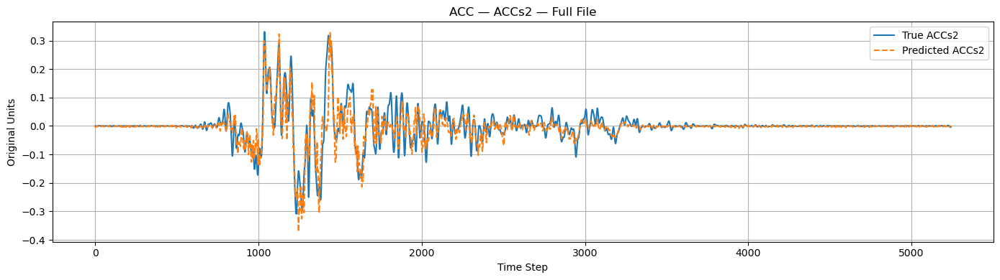

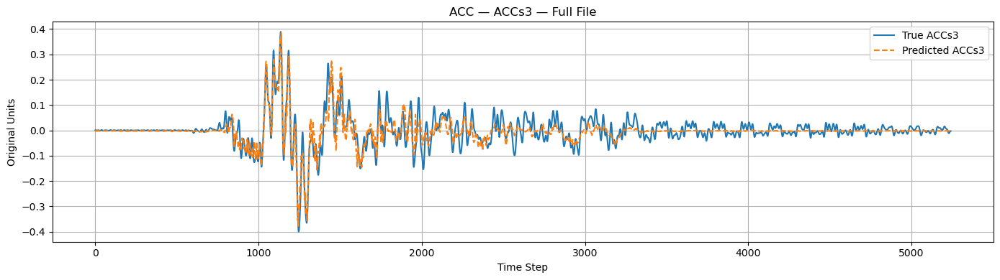

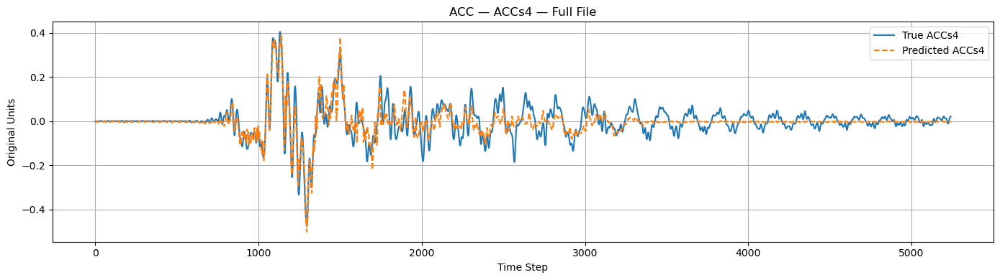

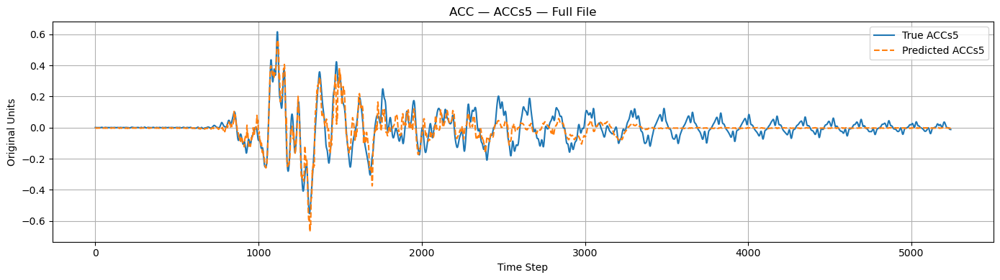


=== Predicting and plotting: filtered_fpi62gm171s3_denoised.txt ===

[INFO] Predicting on entire file: filtered_fpi62gm171s3_denoised.txt


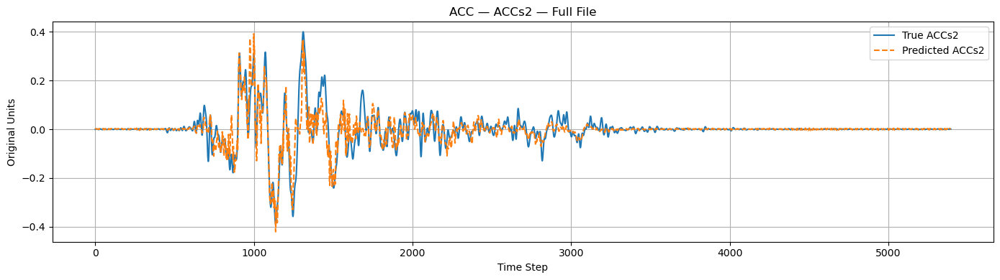

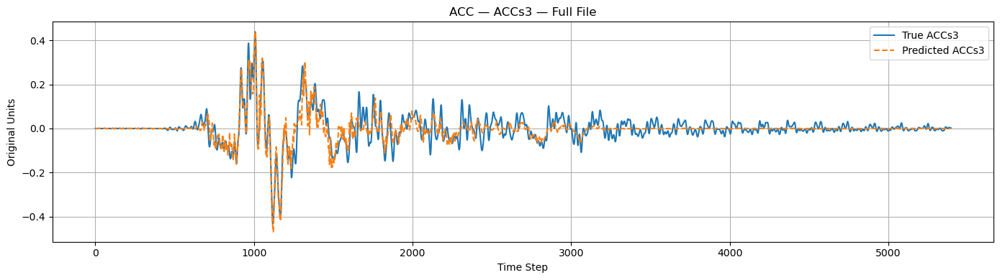

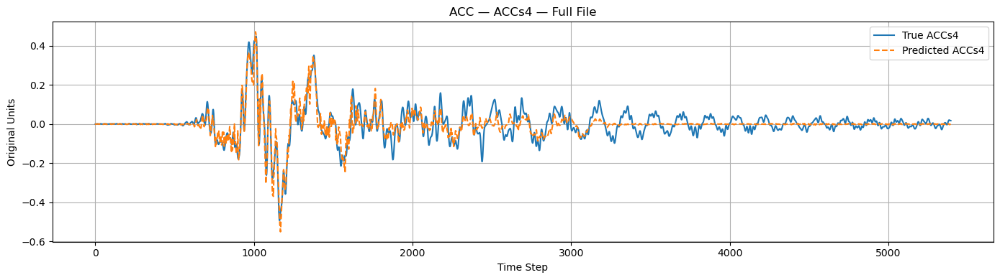

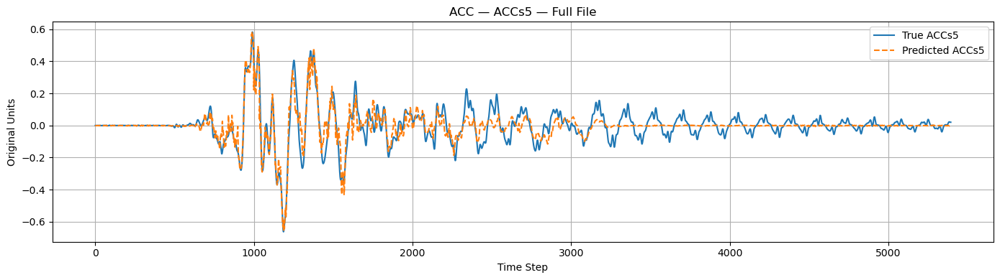


=== Predicting and plotting: filtered_fpi64gm171s2a_denoised.txt ===

[INFO] Predicting on entire file: filtered_fpi64gm171s2a_denoised.txt


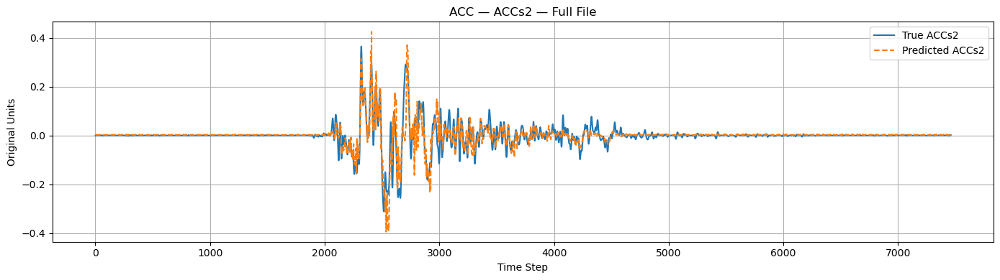

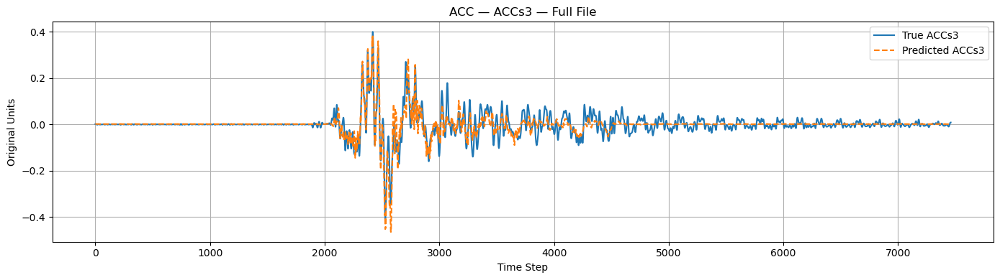

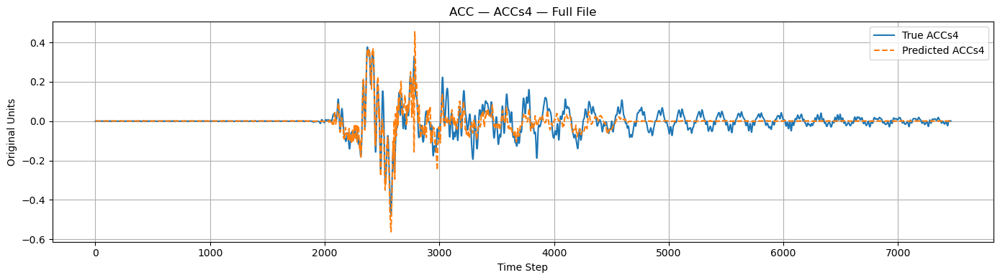

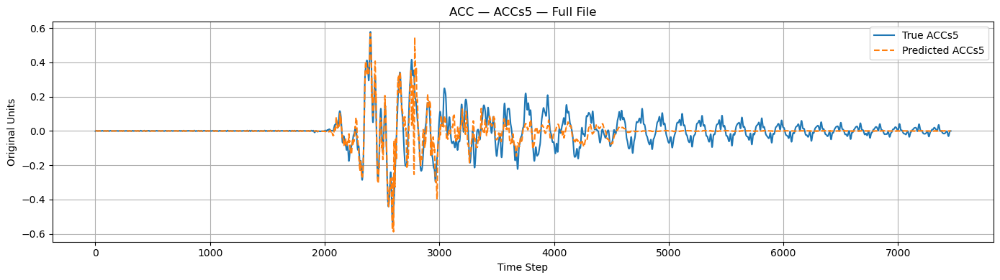


=== Predicting and plotting: filtered_fpi64gm171s3a_denoised.txt ===

[INFO] Predicting on entire file: filtered_fpi64gm171s3a_denoised.txt


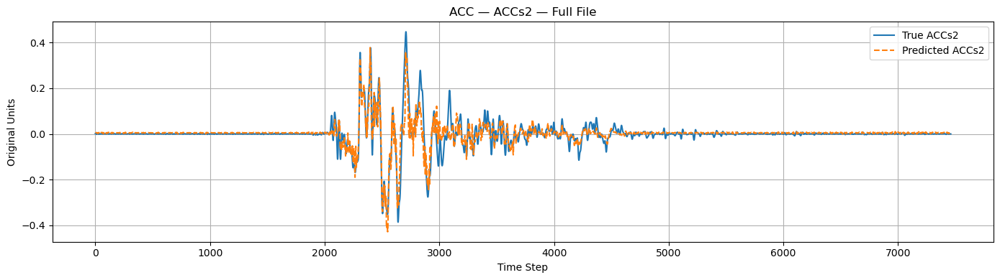

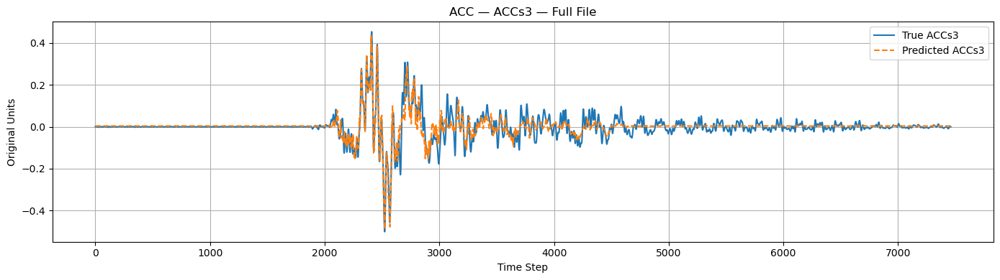

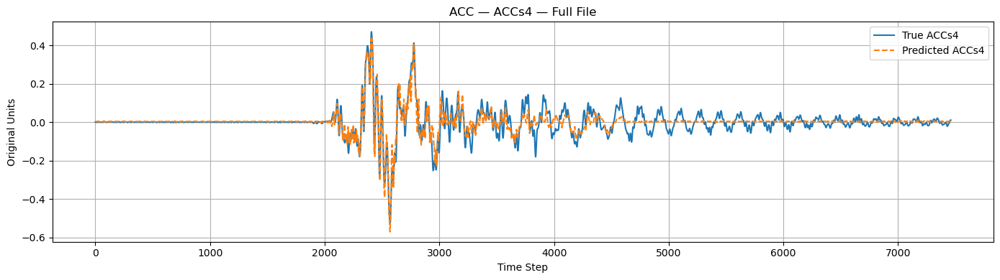

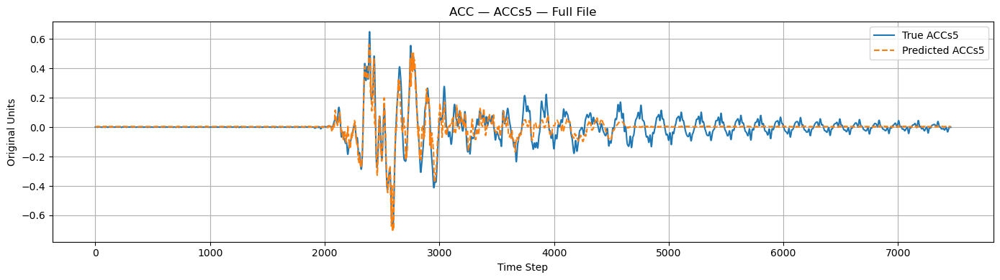

In [19]:
# ==== Loop Through Files for Prediction and Plotting ====
txt_files = sorted([f for f in os.listdir(folder_path) if f.endswith('.txt')])

for fname in txt_files:
    sample_path = os.path.join(folder_path, fname)
    print(f"\n=== Predicting and plotting: {fname} ===")
    inv_true, inv_pred = predict_and_plot_full_file(
        model=model_acc,
        file_path=sample_path,
        input_cols=acc_input,
        target_cols=acc_target,
        scaler=acc_scaler,
        model_name="acc",
        timesteps=timesteps
    )